# 3. Fitting diads once you have groups
- Once you have divided your diads into groups based on strengths, you need to tweak the fit parameters for each group
- Then you can loop through all files in a given group and automatically fit the spectra

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib
import DiadFit as pf
pf.__version__

'0.0.88'

## Specifying filetype, and folder as before

In [2]:
# This specifies what file type your Raman exported in. 
meta_path, spectra_path, spectra_filetype, prefix, str_prefix, spectra_file_ext, meta_file_ext, TruPower=pf.get_settings()

## Load in data and fit parameters
- This loads in the dataframes of the fit parameters you saved in the other file, by group
- At this point you select what group you want to fit (batch = 'Weak', 'Medium' or 'Strong'). After running through the entire notebook for one group, come back up here to fit a second group.

In [3]:
## load dataframes and numpy arrays 
np_x = joblib.load('np_x.sav')

# Select the group you want to fit ('Weak', 'Medium', 'Strong'). After selecting one, go through and select another one and run again from here. 
batch='Weak' # Options are Weak, Medium, Strong

if batch=='Weak':
    GroupN_df=joblib.load('Weak_df.sav')
if batch=='Medium':
    GroupN_df=joblib.load('Medium_df.sav')
if batch=='Strong':
    GroupN_df=joblib.load('Strong_df.sav')

### Now load one file from this group to tweak parameters for

In [4]:
Diad_Files =GroupN_df['filename']
i=0


### Lets plot the diad to have a look at it

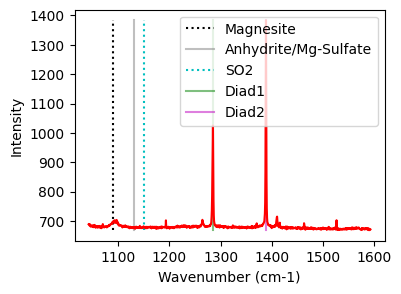

In [5]:
plot1=pf.plot_diad(path=spectra_path, filename=Diad_Files[i], filetype=spectra_filetype)

## Now lets inspect the diads and get their approximate positions
- As with generic peak, you can exclude 2 segments (e.g. around cosmic rays)
- You then specify how many peaks you want to fit on each diad. 1 means just the strong peak, 2 hotbands, and 3 for Diad2 would also fit the C13 peak if present. 
- The identify_diad_peaks then uses scipy findpeaks to identify the positions of the 2 diads, and any other peaks the user asks for. These are saved, and fed into the later functions for peak fitting. 

## Choose a model for fitting all peaks
- Option of Voigt or PseudoVoigt. We recomend PsuedoVoigt

In [6]:
model_name='PseudoVoigtModel'

## Fit Diad 1
- Tweak the parameters in the config files for each group. E.g. how many peaks (fit_peaks), the background positions, the sigma of the diad, and whether or not you want a gaussian background

In [7]:
diad_id_config=pf.diad_id_config(height=50, exclude_range1=[1308, 1309])
diad_id_config

if batch=='Weak':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250),
    upper_bck_diad1=(1300, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Medium':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1240),
    upper_bck_diad1=(1315, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Strong':
    diad1_fit_config_init=pf.diad1_fit_config(
    fit_gauss=True, gauss_amp= 2*GroupN_df['HB1_abs_prom'].iloc[i],
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220),
    upper_bck_diad1=(1330, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=1000, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
diad1_fit_config_init

diad1_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250), upper_bck_diad1=(1300, 1350), fit_gauss=False, gauss_amp=1000, diad_sigma=0.6, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=355.36850845644244, HB_prom=nan, x_range_baseline=30, y_range_baseline=100, dpi=200, x_range_residual=10, return_other_params=False)

### See what these fit parameters look like for diad1

,Diad1_Combofit_Cent,Diad1_Voigt_Cent,Diad1_cent_err,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Voigt_Gamma,Diad1_Combofit_Height,Diad1_Residual,Diad1_Prop_Lor,Diad1_fwhm,Diad1_refit,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad1_PDF_Model
0,1284.835297,1284.835297,0.008164,885.322094,0.911101,0,355.214016,3.789593,0.687949,1.822202,Flagged Warnings:,1.256303,1.281899,0.467035,0.00513,PseudoVoigtModel


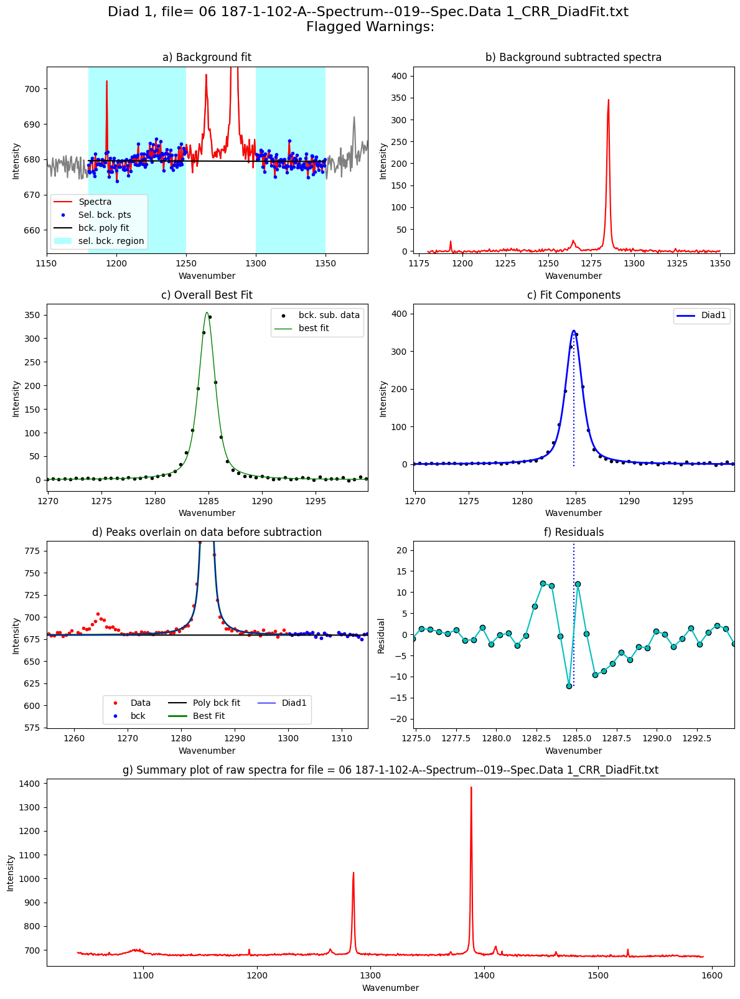

In [8]:
Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config_init,
config2=diad_id_config,
path=spectra_path, filename=Diad_Files.iloc[0],
filetype=spectra_filetype, plot_figure=True, close_figure=False,
Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
HB_pos=GroupN_df['HB1_pos'].iloc[i])
Diad1_fit

### Update the sigma
- The sigma parameter varies quite a lot based on the splitting. Best to update your first guess with what you found for the example file above

In [9]:
diad1_fit_config2=diad1_fit_config_init

## Fit diad2

In [10]:
if batch=='Weak':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=2, upper_bck_diad2=(1430, 1480),
    lower_bck_diad2=(1310, 1360), diad_sigma=0.4,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Medium':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1350), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Strong':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1340), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=1000,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init
diad2_fit_config_init

diad2_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad2=2, lower_bck_diad2=(1310, 1360), upper_bck_diad2=(1430, 1480), fit_gauss=False, gauss_amp=1000, diad_sigma=0.4, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=706.5417470664886, HB_prom=40.21115993158662, C13_prom=10, x_range_baseline=30, y_range_baseline=100, plot_figure=True, dpi=200, x_range_residual=30, return_other_params=False)

### See what these fit parameters look like for diad2

,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,HB2_Cent,HB2_Area,HB2_Sigma,Diad2_Combofit_Height,Diad2_Residual,Diad2_Prop_Lor,Diad2_fwhm,Diad2_refit,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF,Diad2_PDF_Model
0,1388.553416,1388.553366,0.002933,1334.661899,0.680027,0,1409.920541,142.462188,1.23775,706.125083,2.871281,0.72652,1.360054,Flagged Warnings:,1.0225,1.07027,0.030601,0.001926,PseudoVoigtModel


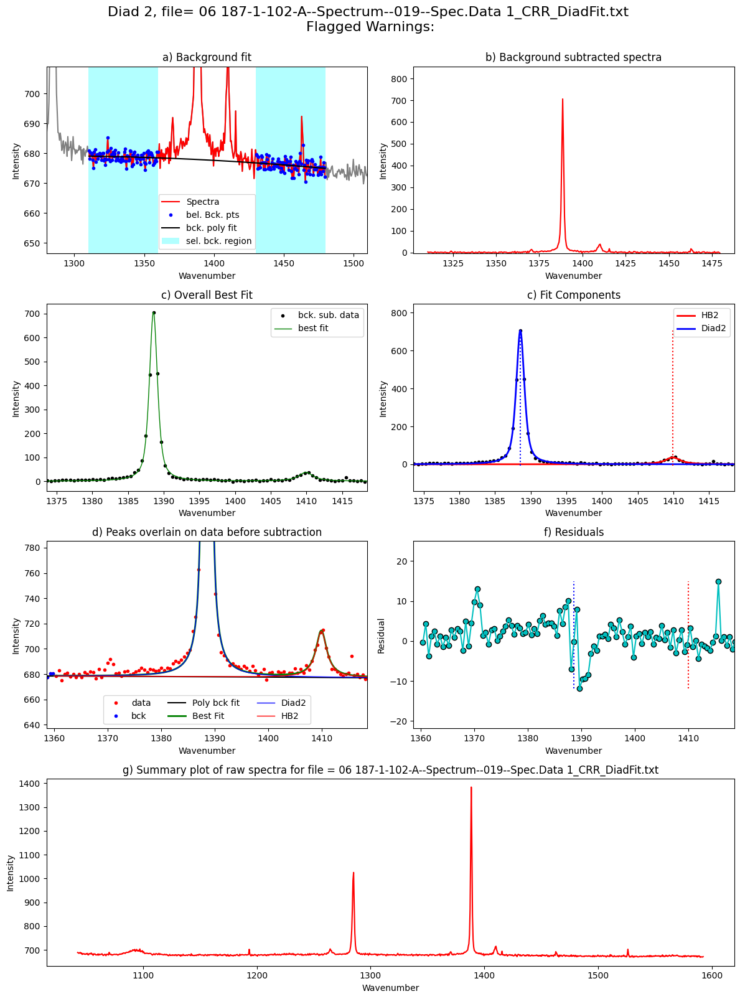

In [11]:
Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
    config2=diad_id_config,
path=spectra_path, filename=Diad_Files[i], filetype=spectra_filetype,
plot_figure=True, close_figure=False, 
Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
HB_pos=GroupN_df['HB2_pos'].iloc[i], 
C13_pos=GroupN_df['C13_pos'].iloc[i])
Diad2_fit.to_clipboard(excel=True)
Diad2_fit

## Loop over all the files in the group
- This will loop over all the 

  0%|          | 0/36 [00:00<?, ?it/s]

Processing file: 06 187-1-102-A--Spectrum--019--Spec.Data 1_CRR_DiadFit.txt


  3%|▎         | 1/36 [00:02<01:31,  2.60s/it]

Processing file: 07 187-1-102-A--Spectrum--020--Spec.Data 1_CRR_DiadFit.txt


  6%|▌         | 2/36 [00:05<01:32,  2.73s/it]

Processing file: 08 187-1-102-A--Spectrum--021--Spec.Data 1.txt


  8%|▊         | 3/36 [00:08<01:30,  2.73s/it]

Processing file: 10 187-1-102-B--Spectrum--025--Spec.Data 1.txt


 11%|█         | 4/36 [00:10<01:22,  2.58s/it]

Processing file: 11 187-1-102-B--Spectrum--026--Spec.Data 1_CRR_DiadFit.txt


 14%|█▍        | 5/36 [00:13<01:19,  2.57s/it]

Processing file: 12 187-1-102-B--Spectrum--027--Spec.Data 1.txt


 17%|█▋        | 6/36 [00:15<01:14,  2.47s/it]

Processing file: 14 187-1-102-C--Spectrum--031--Spec.Data 1_CRR_DiadFit.txt


 19%|█▉        | 7/36 [00:17<01:08,  2.37s/it]

Processing file: 15 187-1-102-C--Spectrum--032--Spec.Data 1.txt


 22%|██▏       | 8/36 [00:20<01:07,  2.42s/it]

Processing file: 16 187-1-102-C--Spectrum--033--Spec.Data 1.txt


 25%|██▌       | 9/36 [00:22<01:04,  2.38s/it]

Processing file: 18 187-1-102-B--Spectrum--036--Spec.Data 1.txt


 28%|██▊       | 10/36 [00:24<01:03,  2.43s/it]

Processing file: 19 187-1-102-B--Spectrum--037--Spec.Data 1_CRR_DiadFit.txt


c:\users\charl\documents\python dev\diadfit\src\DiadFit\diads.py:3104: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes=plt.subplot_mosaic(mosaic=figure_mosaic, figsize=(12, 16))
 31%|███       | 11/36 [00:28<01:06,  2.66s/it]

Processing file: 20 187-1-102-B--Spectrum--038--Spec.Data 1_CRR_DiadFit.txt


 33%|███▎      | 12/36 [00:30<01:01,  2.57s/it]

Processing file: 22 187-1-103-A--Spectrum--044--Spec.Data 1_CRR_DiadFit.txt


 36%|███▌      | 13/36 [00:32<00:56,  2.48s/it]

Processing file: 23 187-1-103-A--Spectrum--045--Spec.Data 1_CRR_DiadFit.txt


 39%|███▉      | 14/36 [00:34<00:51,  2.32s/it]

Processing file: 24 187-1-103-A--Spectrum--046--Spec.Data 1_CRR_DiadFit.txt


 42%|████▏     | 15/36 [00:36<00:47,  2.24s/it]

Processing file: 26 187-1-103-B--Spectrum--050--Spec.Data 1_CRR_DiadFit.txt


 44%|████▍     | 16/36 [00:38<00:44,  2.20s/it]

Processing file: 27 187-1-103-B--Spectrum--051--Spec.Data 1_CRR_DiadFit.txt


 47%|████▋     | 17/36 [00:41<00:43,  2.28s/it]

Processing file: 28 187-1-103-B--Spectrum--052--Spec.Data 1_CRR_DiadFit.txt


 50%|█████     | 18/36 [00:43<00:40,  2.23s/it]

Processing file: 30 187-1-103-C--Spectrum--056--Spec.Data 1_CRR_DiadFit.txt


 53%|█████▎    | 19/36 [00:45<00:37,  2.20s/it]

Processing file: 31 187-1-103-C--Spectrum--057--Spec.Data 1_CRR_DiadFit.txt


 56%|█████▌    | 20/36 [00:47<00:34,  2.14s/it]

Processing file: 32 187-1-103-C--Spectrum--058--Spec.Data 1_CRR_DiadFit.txt


 58%|█████▊    | 21/36 [00:49<00:31,  2.12s/it]

Processing file: 34 187-1-104-A--Spectrum--066--Spec.Data 1_CRR_DiadFit.txt


 61%|██████    | 22/36 [00:51<00:29,  2.07s/it]

Processing file: 35 187-1-104-A--Spectrum--067--Spec.Data 1_CRR_DiadFit.txt


 64%|██████▍   | 23/36 [00:53<00:28,  2.17s/it]

Processing file: 36 187-1-104-A--Spectrum--068--Spec.Data 1_CRR_DiadFit.txt


 67%|██████▋   | 24/36 [00:55<00:25,  2.13s/it]

Processing file: 39 187-1-105-reg1-A--Spectrum--077--Spec.Data 1_CRR_DiadFit.txt


 69%|██████▉   | 25/36 [00:58<00:23,  2.16s/it]

Processing file: 40 187-1-105-reg1-A--Spectrum--078--Spec.Data 1_CRR_DiadFit.txt


 72%|███████▏  | 26/36 [01:00<00:22,  2.21s/it]

Processing file: 41 187-1-105-reg1-A--Spectrum--079--Spec.Data 1_CRR_DiadFit.txt


 75%|███████▌  | 27/36 [01:02<00:20,  2.24s/it]

Processing file: 43 187-1-105-reg1-B--Spectrum--083--Spec.Data 1_CRR_DiadFit.txt


 78%|███████▊  | 28/36 [01:05<00:18,  2.37s/it]

Processing file: 44 187-1-105-reg1-B--Spectrum--084--Spec.Data 1_CRR_DiadFit.txt


 81%|████████  | 29/36 [01:07<00:16,  2.34s/it]

Processing file: 45 187-1-105-reg1-B--Spectrum--085--Spec.Data 1_CRR_DiadFit.txt


 83%|████████▎ | 30/36 [01:10<00:14,  2.37s/it]

Processing file: 46 187-1-105-reg1-C--Spectrum--088--Spec.Data 1_CRR_DiadFit.txt


 86%|████████▌ | 31/36 [01:12<00:11,  2.35s/it]

Processing file: 47 187-1-105-reg1-C--Spectrum--089--Spec.Data 1_CRR_DiadFit.txt


 89%|████████▉ | 32/36 [01:14<00:09,  2.35s/it]

Processing file: 48 187-1-105-reg1-C--Spectrum--090--Spec.Data 1_CRR_DiadFit.txt


 92%|█████████▏| 33/36 [01:17<00:07,  2.36s/it]

Processing file: 50 187-1-105-reg2-A--Spectrum--094--Spec.Data 1_CRR_DiadFit.txt


 94%|█████████▍| 34/36 [01:19<00:04,  2.36s/it]

Processing file: 51 187-1-105-reg2-A--Spectrum--095--Spec.Data 1_CRR_DiadFit.txt


 97%|█████████▋| 35/36 [01:22<00:02,  2.46s/it]

Processing file: 52 187-1-105-reg2-A--Spectrum--096--Spec.Data 1_CRR_DiadFit.txt


100%|██████████| 36/36 [01:24<00:00,  2.35s/it]


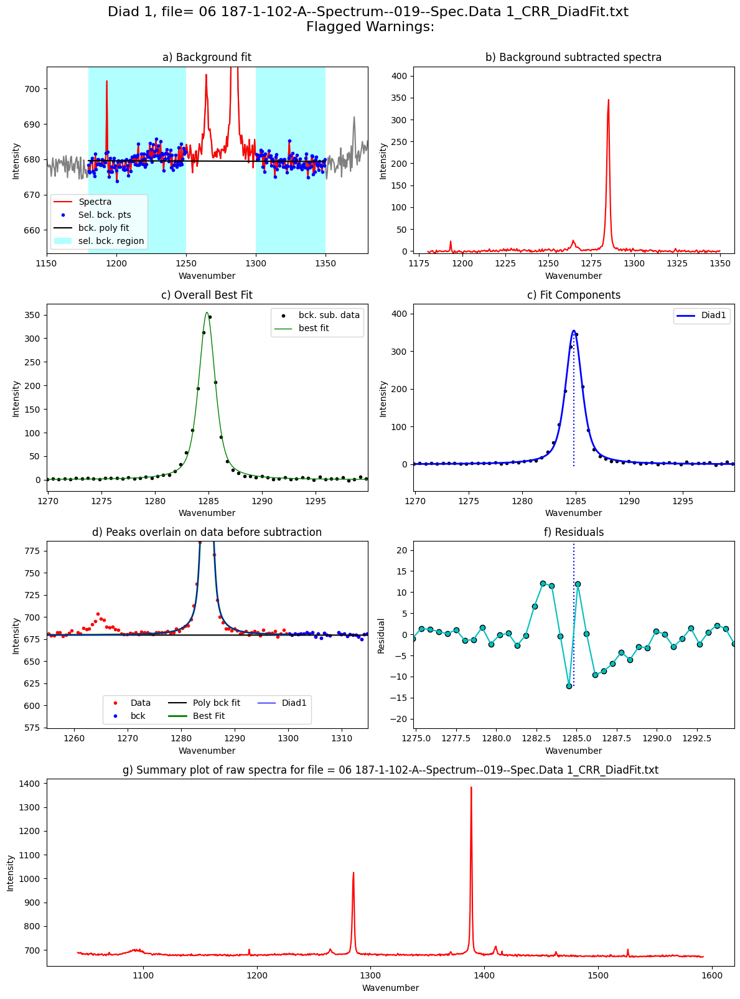

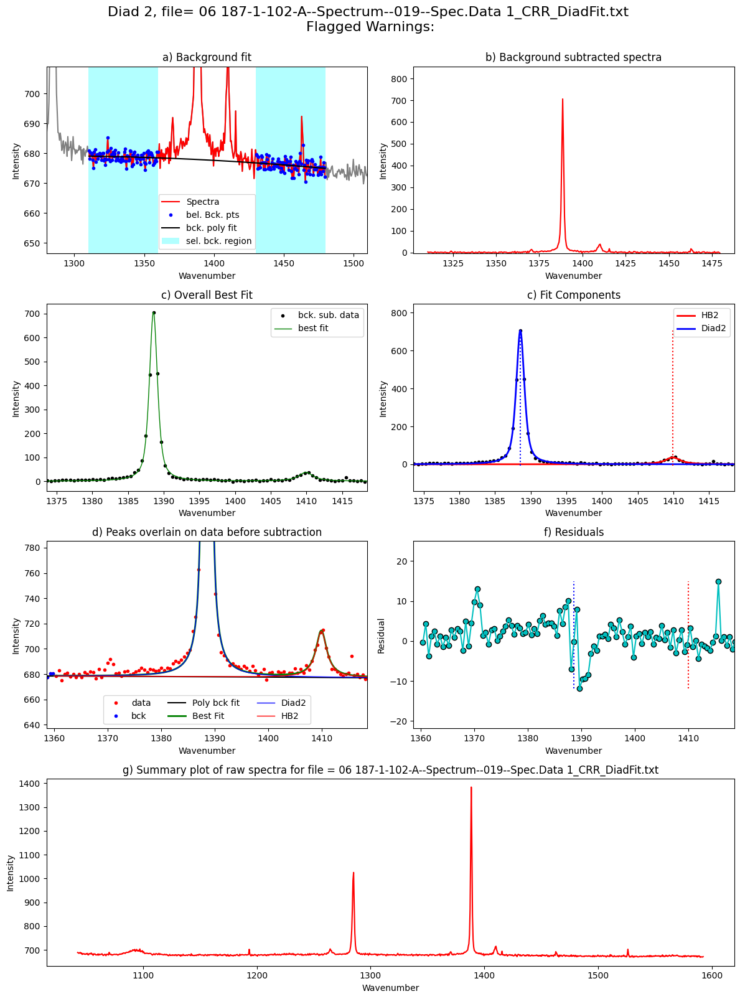

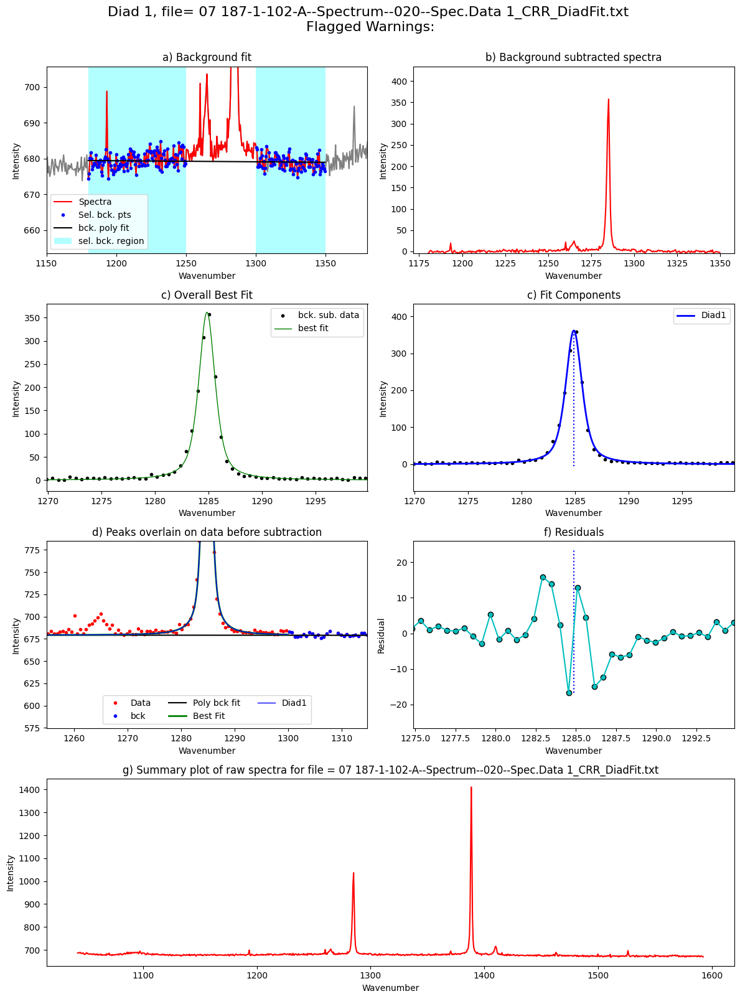

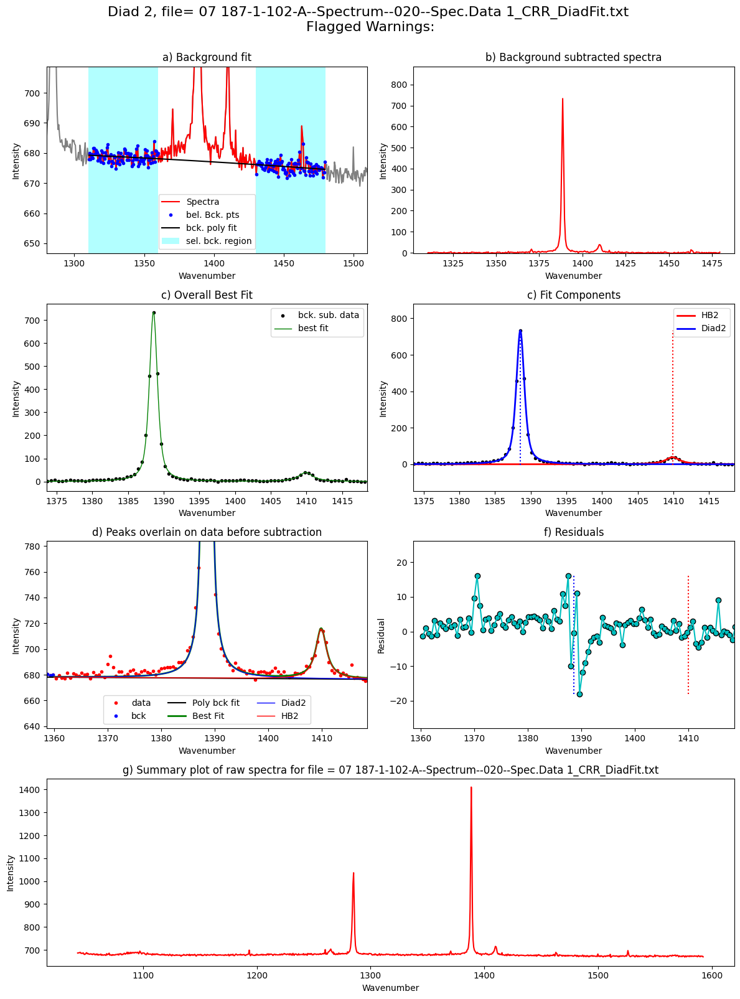

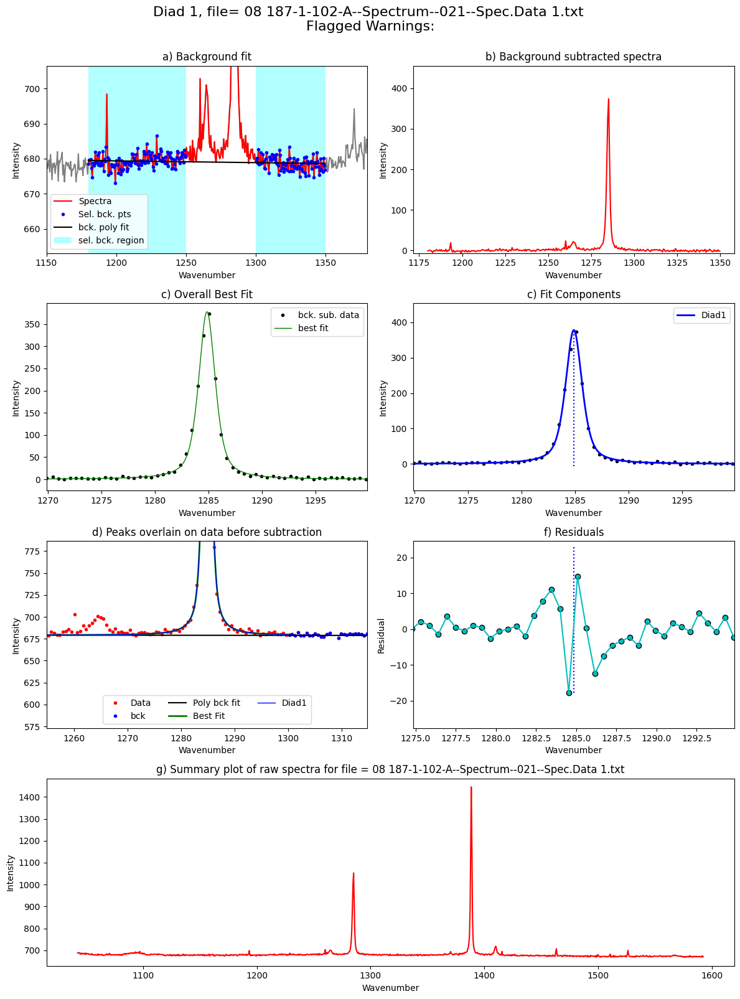

...

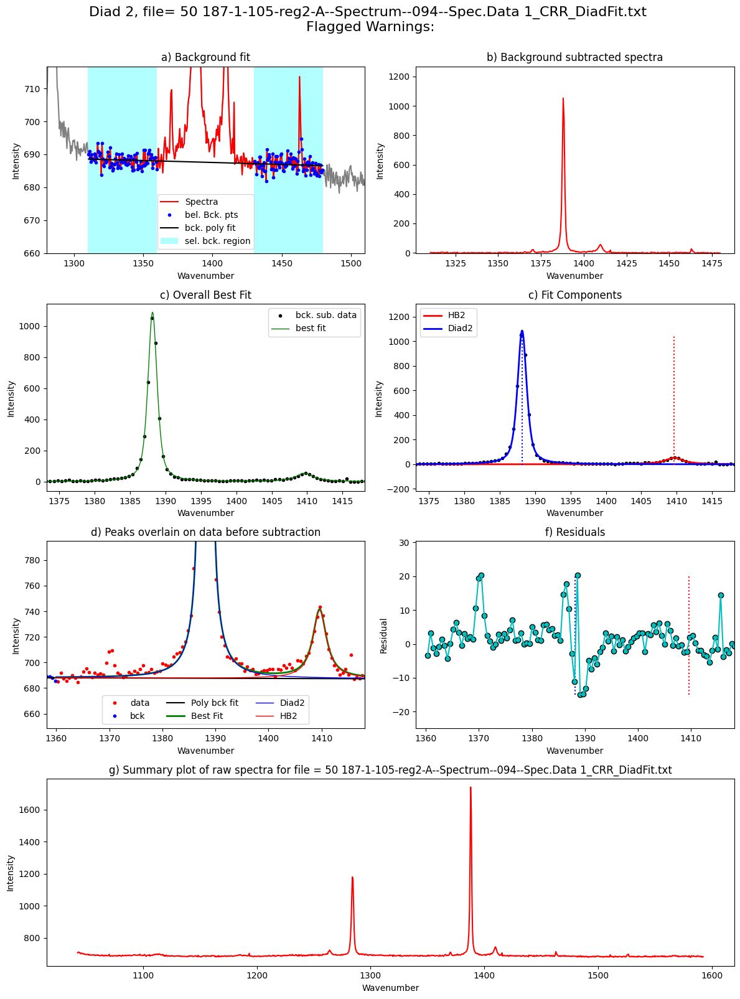

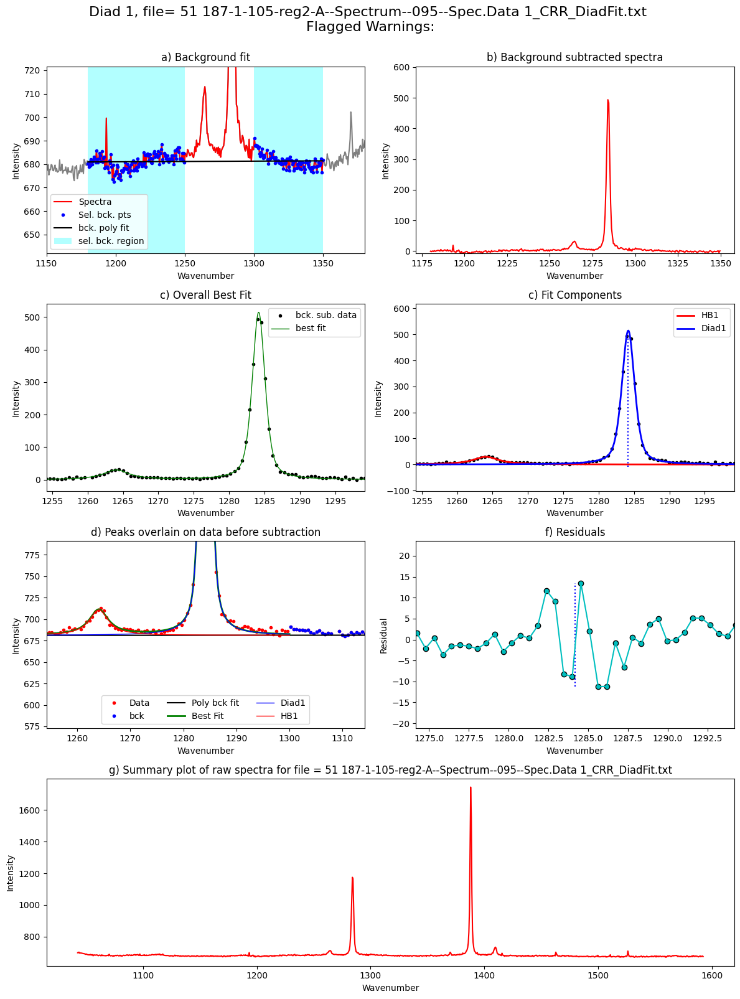

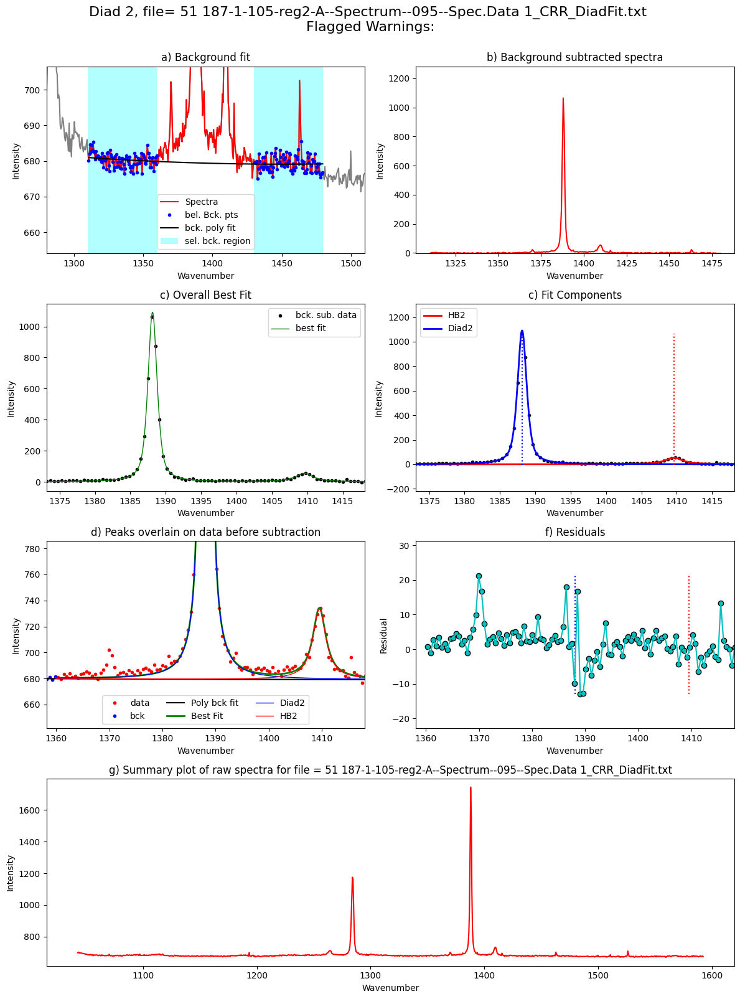

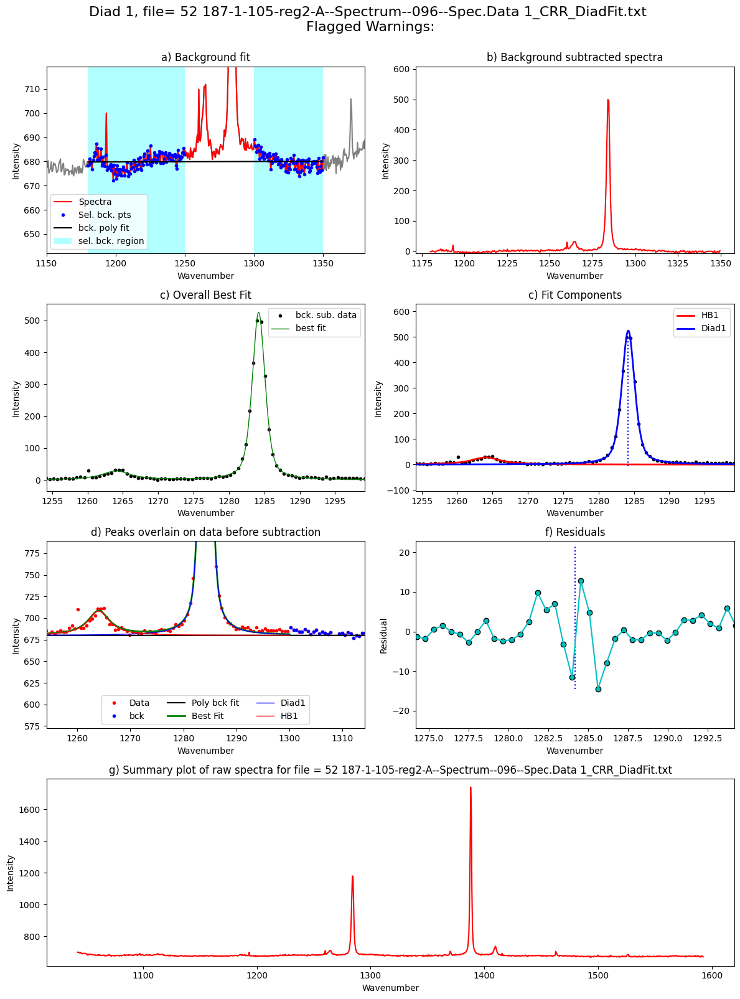

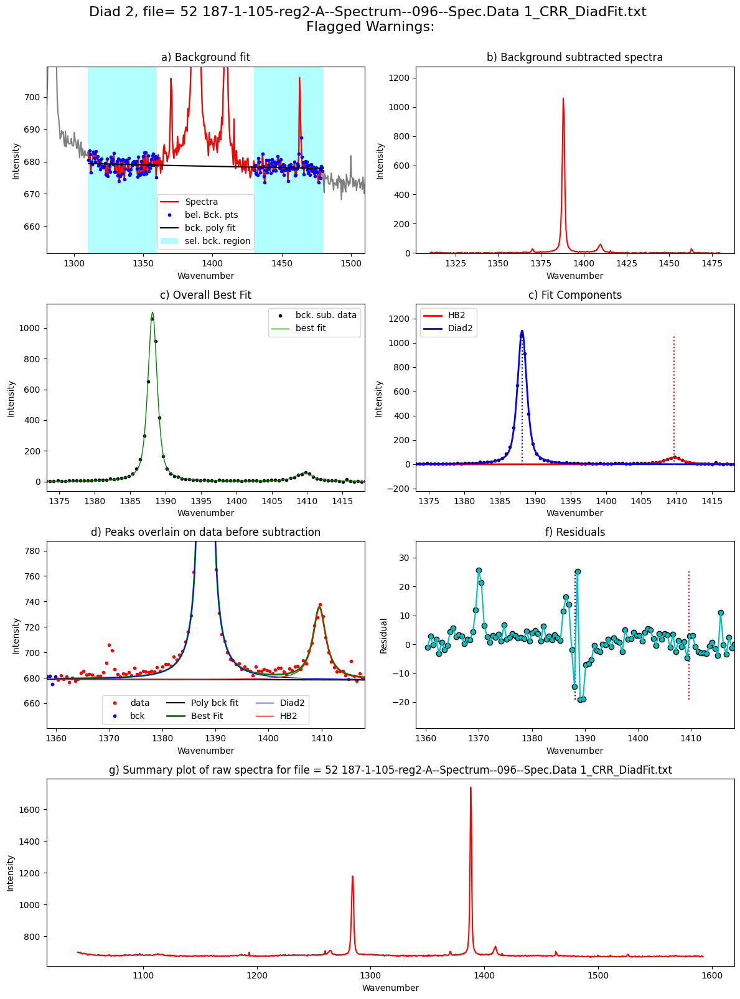

In [12]:
from tqdm import tqdm
plot_figure=True# If False, Means doesnt have to make figures, lot faster. 
close_figure=False # If True, wont show figures in notebook, but will still save them in a folder 
Diad_Files_i=Diad_Files
df_Merge = pd.DataFrame([])
for i in tqdm(range(0, len(Diad_Files))): #
    tqdm.write(f"Processing file: {Diad_Files[i]}")
    
    
    # For diad1, config file like you had in the previous. 
    # Only really used to exclude a range (say your spectra has a known spec)
    diad_id_config=pf.diad_id_config(exclude_range1=[1308, 1309])
    
    # Here, the prominence are taken from the fitting in the last notebook
    diad1_fit_config2.HB_prom=GroupN_df['HB1_abs_prom'].iloc[i]
    diad1_fit_config2.diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i]
    diad1_fit_config2.gauss_amp=2*GroupN_df['HB1_abs_prom'].iloc[i]

    Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config2,
    config2=diad_id_config, path=spectra_path, filename=GroupN_df['filename'].iloc[i],
    filetype=spectra_filetype, plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
    HB_pos=GroupN_df['HB1_pos'].iloc[i])

    ## Same for diad2, just also has a C13 peak
    diad2_fit_config_init.HB_prom=GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i]
    diad2_fit_config_init.gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.C13_prom=GroupN_df['C13_abs_prom'].iloc[i]
    
    
    Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
        config2=diad_id_config,
    path=spectra_path, filename=GroupN_df['filename'].iloc[i], 
    filetype=spectra_filetype,
    plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
    HB_pos=GroupN_df['HB2_pos'].iloc[i], 
    C13_pos=GroupN_df['C13_pos'].iloc[i])
    
    # This combines the outputs into a single dataframe
    data=pf.combine_diad_outputs(filename=GroupN_df['filename'].iloc[i], prefix=prefix, 
    Diad1_fit=Diad1_fit, path=spectra_path,                  
    Diad2_fit=Diad2_fit)        
    
 

    df_Merge = pd.concat([df_Merge, data], axis=0).reset_index(drop=True)


In [13]:
# Save parameters to excel
combo=df_Merge

if batch=='Weak':
    combo.to_excel('Weak_Diads.xlsx', index=False)
if batch=='Medium':
    combo.to_excel('Medium_Diads.xlsx', index=False)
if batch=='Strong':
    combo.to_excel('Strong_Diads.xlsx', index=False)

In [14]:
combo

,filename,Splitting,Split_σ,Diad1_Combofit_Cent,Diad1_cent_err,Diad1_Combofit_Height,Diad1_Voigt_Cent,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Residual,...,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF,Diad1_PDF_Model,Diad2_PDF_Model
0,187-1-102-A--Spectrum--019--Spec.Data 1_CRR_Di...,103.718069,0.008675,1284.835297,0.008164,355.214016,1284.835297,885.322094,0.911101,3.789593,...,1.256303,1.281899,0.467035,0.005130,1.022500,1.070270,0.030601,0.001926,PseudoVoigtModel,PseudoVoigtModel
1,187-1-102-A--Spectrum--020--Spec.Data 1_CRR_Di...,103.686997,0.009487,1284.868110,0.009025,361.446083,1284.868110,911.726755,0.910986,4.507386,...,1.317597,1.364615,0.578652,0.005041,1.027778,1.104779,0.037530,0.001842,PseudoVoigtModel,PseudoVoigtModel
2,187-1-102-A--Spectrum--021--Spec.Data 1,103.698416,0.008905,1284.857096,0.008273,377.857267,1284.857096,957.043077,0.922556,4.173163,...,1.365011,1.336874,0.673486,0.004883,1.032419,1.087591,0.044229,0.001771,PseudoVoigtModel,PseudoVoigtModel
3,187-1-102-B--Spectrum--025--Spec.Data 1,103.854442,0.039428,1284.492252,0.038517,71.675762,1284.492252,192.412278,1.002064,1.470761,...,1.009885,1.052830,0.019810,0.027961,1.110048,1.154255,0.156092,0.009459,PseudoVoigtModel,PseudoVoigtModel
4,187-1-102-B--Spectrum--026--Spec.Data 1_CRR_Di...,103.804642,0.029606,1284.566782,0.027281,51.581561,1284.566782,136.562500,1.014792,1.235212,...,1.172348,1.271141,0.349796,0.039347,1.062791,1.070588,0.091635,0.013398,PseudoVoigtModel,PseudoVoigtModel
5,187-1-102-B--Spectrum--027--Spec.Data 1,103.888581,0.048638,1284.471589,0.046695,36.494254,1284.471589,106.991658,1.063679,1.226960,...,1.446970,1.251295,0.950865,0.058293,1.281337,1.228516,0.364402,0.015284,PseudoVoigtModel,PseudoVoigtModel
6,187-1-102-C--Spectrum--031--Spec.Data 1_CRR_Di...,103.855594,0.015224,1284.503615,0.014167,235.852356,1284.503615,666.001099,1.045981,3.855220,...,1.227191,1.294350,0.475276,0.008870,1.120393,1.135957,0.170063,0.002801,PseudoVoigtModel,PseudoVoigtModel
7,187-1-102-C--Spectrum--032--Spec.Data 1,103.818992,0.014006,1284.535552,0.013284,242.321617,1284.535552,683.005696,0.992391,3.915125,...,1.093525,1.267366,0.185627,0.008191,1.170732,1.167832,0.250888,0.002927,PseudoVoigtModel,PseudoVoigtModel
8,187-1-102-C--Spectrum--033--Spec.Data 1,103.847940,0.016179,1284.485895,0.015172,232.527546,1284.485895,661.622122,1.017796,4.061701,...,1.197861,1.239102,0.402764,0.008754,1.167476,1.178322,0.246697,0.003030,PseudoVoigtModel,PseudoVoigtModel
9,187-1-102-B--Spectrum--036--Spec.Data 1,103.853265,0.006619,1284.484193,0.006066,585.017671,1284.484243,1653.044269,1.045414,4.139639,...,1.088629,1.159601,0.185307,0.003574,1.186104,1.183746,0.268811,0.001141,PseudoVoigtModel,PseudoVoigtModel


### This plays a sound when the notebook is done if you have a tendency to procrastinate

In [15]:
# !pip install winotify

from winotify import Notification, audio

toast= Notification(app_id="VSCode",title="Notebook completed",
                    msg="Step3b_Secondary_Peaks is done!",
                    duration="short")
toast.set_audio(audio.Mail,loop=False)
toast.show()